# Primer Examen 15%

A) Cargando el archivo JSON: 
* https://github.com/restrepo/anomaly/raw/main/solutions.json.gz

en Pandas

1) Adicione una columna nueva `'smax'` con el valor máximo en valor absoluto de la lista de enteros de la correspondiente entrada en la columna '`solution`'
2) Adicione dos columnas nuevas: `'sum_s'` (`sum_s³`) con el resultado de la suma (al cubo) de todos los números de la lista de enteros de la correspondiente entrada en la columna '`solution`'
3) Usando como semilla el número de su cédula, genere un número entero de forma aleatoria entre 0 y 390073. Seleccione el la fila correspondiente a ese número entero y construya un polinomio con esos coeficientes. Encuentre las raices reales de ese polinomio y realice el correspondiente gráfico incluyendo: el polinomio generado, sus raices (como puntos en gráfico) y la derivada del polinomio. Optimize el rango de valores en el eje $x$ y en el eje $y$ del gráfico, de manera que el polinomio y sus raices se visualicen de la mejor forma posible. (Sugerencia → use: `plt.ylim(ymin,ymax)` ). Se tendrá en cuenta la estética del gráfico presentado incluyendo la rotulación adecuada del mismo


In [150]:
import random
import numpy as np
from scipy import optimize
import matplotlib.pylab as plt
import pandas as pd
import numpy as np


In [151]:
from google.colab import files
files.upload()

Saving solutions.json.gz to solutions.json (4).gz


{'solutions.json.gz': b'\x1f\x8b\x08\x08E\xc6\xb7`\x02\xffsolutions.json\x00\xa4\xbd\xd9\xce\xed0\xd2\x1d\xf6.}-\x01\x9c$J~\x15#W\t\x10\x186\xe2\x8b$WA\xde=g\x8b\xacb\x91\\\xc5\xe1\x0b\xfa|\xbf\x81vC\xdc\xa28\xd4\xb0\x86\xff\xfa\xff\xfc\xe7\x7f\xfc\xe7\xbf\xfc\xd7\xd3\x1e\xe6\xc8\xff\xe7\x7f9\xfe\xf3\xdf\xc5\x7fe\xd3\x7f\xf5\x7f\xfe\xcf\xff\xf1\x7f\xff_\xff\xed\x7f\xfe\x1f\xff\xfe\x7f\xec\x11\xbe\xff\x9cW\xf5\xef>\xee\x7f\xff\xbb\xff\xfd\x7f\xfd\xdf\xfe\xf3_\xec\xf1\x9f\x7f\xffCk\xff\xdf\x83\x1f\xdf<\xb6}\xa2\xfb\xf7\x9f\xd3\xe7\x7f\xa1~N\xa4\xc7\xd8\xf4\x13\xad\xf8\x91.\xfd\xc8\xdf\xff\xdb>\xf2\xfboOz\xec\x95\xffs\xde\xff\xfe\xd1\xf3]\xfa\x9dN\xfeN\xf1\xcey\x04\x9e\x9c~\x84\xdf\x7f\x1c\xff\xf8\xf0\xfd\xbb\x8f\xd8\xcc\x83+/\xf0\xfb\xf5\xa6}z\x1e\x03=>\xbf\x02M\xf0\x11\x8f\xf3\xd1fY\x9f\x1e\xfd\xe1\xf7\xf7\x9f3\x96\x7f\xaf\xf6\xe3\xd3s\xe0\xdct\xb3\xff\x9b\x11\xff\xfd\xe7\xdf\xef\xfe\xfd\xe6\x7f\xffC\xf3\xfdY?Z$\xf9\xe7\xca\x9fo\xc1\xdc\xf0\x94\xe7o*~\xbe5\xfa\xe4\xf3\xe7\x05\xb3\x7f\xb

In [152]:
df = pd.read_json("solutions.json.gz")
df

,l,k,solution,gcd,n
0,"[-1, 0, -1, 0, -1]","[-1, 0, -1, 1, -1]","[1, 4, 4, 4, -5, -5, -5, -5, -5, 6, 6]",1,11
1,"[-1, 1]","[-1, 0, -1]","[1, 2, 2, -3, -3, -3, 4]",1,7
2,"[1, -1, 0, 1, -1]","[-2, 0, -1, -2, 0]","[1, 1, -2, -2, -3, -3, 5, 5, 5, 5, -6, -6]",2,12
3,"[-1, 1, -1, 1, -1]","[-2, -1, 0, -1, 0]","[1, 1, 1, 1, 2, 2, 2, -3, -4, -4, -6, 7]",1,12
4,"[1, 0, 1, 0, -1]","[-2, -1, -2, -1, 0]","[1, 1, 1, -2, -2, -5, -5, 6, 6, 7, -8]",1,11
...,...,...,...,...,...
390069,"[-3, -15, -6]","[-3, 8, 9]","[8, -9, -9, 11, 25, -29, -29, 32]",36,8
390070,"[-10, -5, -15]","[-10, -12, 12]","[5, 5, 5, -17, -27, -27, 28, 28]",100,8
390071,"[15, -1, 15]","[-14, -13, -14]","[14, -15, -16, 17, -30, 31, 31, -32]",1,8
390072,"[-15, -9, -1]","[-13, -14, -12]","[11, -13, -15, 19, 23, -26, -30, 31]",18,8


In [154]:
# valor maximo de las listas con valor absoluto

smax=[]
rango=len(df["solution"]) # numero de elementos de la columna solution
for i in range (0,rango):
  listas=pd.Series(df["solution"][i])
  smax.append(max(listas.abs()))

In [155]:
# suma de los valores y los cubos

sum_s=[]
sum_scubo=[]
for i in range (0,rango):
  listas=pd.Series(df["solution"][i])
  sum_s.append(sum(listas))
  sum_scubo.append((sum(listas))**3)

# Se agregan las 3 columnas al dataframe
df["smax"]=smax
df["sum_s"]=sum_s
df["sum_s3"]=sum_scubo
df

,l,k,solution,gcd,n,smax,sum_s,sum_s3
0,"[-1, 0, -1, 0, -1]","[-1, 0, -1, 1, -1]","[1, 4, 4, 4, -5, -5, -5, -5, -5, 6, 6]",1,11,6,0,0
1,"[-1, 1]","[-1, 0, -1]","[1, 2, 2, -3, -3, -3, 4]",1,7,4,0,0
2,"[1, -1, 0, 1, -1]","[-2, 0, -1, -2, 0]","[1, 1, -2, -2, -3, -3, 5, 5, 5, 5, -6, -6]",2,12,6,0,0
3,"[-1, 1, -1, 1, -1]","[-2, -1, 0, -1, 0]","[1, 1, 1, 1, 2, 2, 2, -3, -4, -4, -6, 7]",1,12,7,0,0
4,"[1, 0, 1, 0, -1]","[-2, -1, -2, -1, 0]","[1, 1, 1, -2, -2, -5, -5, 6, 6, 7, -8]",1,11,8,0,0
...,...,...,...,...,...,...,...,...
390069,"[-3, -15, -6]","[-3, 8, 9]","[8, -9, -9, 11, 25, -29, -29, 32]",36,8,32,0,0
390070,"[-10, -5, -15]","[-10, -12, 12]","[5, 5, 5, -17, -27, -27, 28, 28]",100,8,28,0,0
390071,"[15, -1, 15]","[-14, -13, -14]","[14, -15, -16, 17, -30, 31, 31, -32]",1,8,32,0,0
390072,"[-15, -9, -1]","[-13, -14, -12]","[11, -13, -15, 19, 23, -26, -30, 31]",18,8,31,0,0


In [156]:
t=random.seed(1098807231)
t=random.randint(0,390073)


c=df["solution"][t] # coeficientes para el polinomio extraidos de la lista 

poli=np.poly1d(df["solution"][t]) #polinomio a partir de los coeficientes

pprima=np.polyder(poli) # derivada del polinomio

raiz=np.roots(poli) # raices del polinomio


r=[]
for i in (raiz): #  solo las raices reales
  if i.imag==0:           
    r.append(i.real)
print(r)

[1.000000000000001]


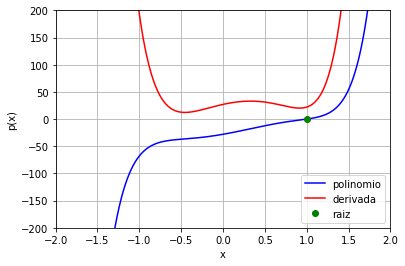

In [157]:
# grafica  
x=np.arange(-5,5, 0.0001) 
plt.plot(x,poli(x),label="polinomio",color="blue")
plt.plot(x,pprima(x),label="derivada",color="red")
plt.plot(r,poli(r),"go",label="raiz")
plt.ylim(-0.2e3,0.2e3) 
plt.xlim(-2,2)    
plt.xlabel("x")
plt.ylabel("p(x)")
plt.grid()
plt.legend()

B)

I) Usando como semilla el número de su cédula, genere de forma aletoria un número entero entre 1 y 5

II) De acuerdo al entero obtenido, escoja una de las siguientes cinco funciones 
1. $$x\operatorname{e}^x=p\,, $$
2. $$\frac{\sin x}{x}=+p\,,$$
3. $$\frac{\sin x}{x}=-p\,,$$
4. $$\frac{\cos x}{x}=+p\,,$$
5. $$\frac{\cos x}{x}=-p\,,$$
III) Genere un número aleatorio entre 0 y 1 y asignelo al valor de $p$
IV) Encuentre la soluciónes a la ecuación trascendental para el intervalo $x$ entre -10 y 10 y gráfique la correspondiente función trascendental y las correspondientes soluciones. . Se tendrá en cuenta la estética del gráfico presentado incluyendo la rotulación adecuada del mismo.

A modo de nota curiosa: estas ecuaciones trascendentales están asociadas a soluciones de la ecuación de Schödinger en mecánica cuántica: https://doi.org/10.1080/14786435.2015.1081425

In [169]:
n= random.seed(1098807231) #numero aleatorio con la cedula como semmilla
n= random.randint(1,5)
n

1

In [170]:
p=random.random() #numero aleatorio de 0 a 1
p

0.015795609335802485

1. $$x\operatorname{e}^x=0.015795609335802485\,, $$

In [179]:
f=lambda x: x*np.exp(x)-p

(-5.0, 10.0)

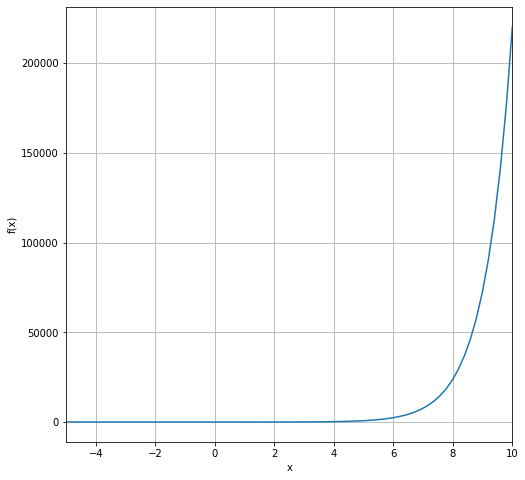

In [180]:
plt.figure(figsize=(8,8))   # Grafica funcion
plt.grid()
plt.plot(x,f(x), label="f(x)")  
plt.xlabel("x")
plt.ylabel("f(x)")
plt.xlim(-5,10)

In [174]:
x=np.linspace(-10,10,100) #raiz
root=optimize.newton(f,0)
print(root)

0.01555185855523619


(-5.0, 10.0)

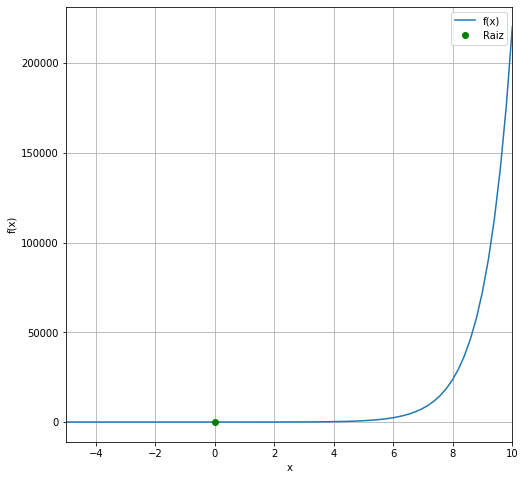

In [181]:
plt.figure(figsize=(8,8))
plt.grid()
plt.plot(x,f(x), label="f(x)")  # Grafica funcion
plt.plot(root,f(root),"go",label="Raiz") # raiz
plt.legend()
plt.xlabel("x")
plt.ylabel("f(x)")
plt.xlim(-5,10)